In [2]:
#import the required libraries
import os
import json
import numpy as np
import pandas as pd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import tensorflow as tf
import soundfile as sf
import IPython
from time import process_time 
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix
import seaborn as sn

# 1. Data Description and Preprocessing

The entire GTZAN dataset was downloaded from https://www.kaggle.com/andradaolteanu/gtzan-dataset-music-genre-classification
and stored locally.  Only the raw/original GTZAN dataset was used, which is a collection of 10 genres with 100 audio 
files each, all having a length of 30 seconds.

The GTZAN dataset is the most-used public dataset for evaluation in machine listening research for music genre 
recognition (MGR). The files were collected in 2000-2001 from a variety of sources including personal CDs, radio, 
microphone recordings, in order to represent a variety of recording conditions.


# 1a. Blues

In [122]:
# 'Blues' sample audio file
song_blues, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/blues/blues.00001.wav')
IPython.display.Audio(song_blues, rate=sr)

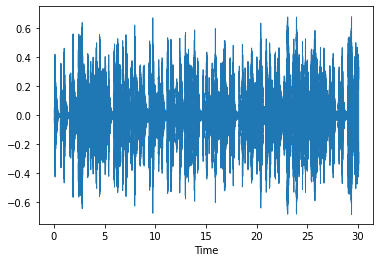

In [100]:
# 'Blues' wave plot: visual depiction of audio files
librosa.display.waveshow(song_blues)

In [102]:
# Spectrogram generator
def plot_spectrogram(Y, sr, hop_length, y_axis="linear"):
    plt.figure(figsize=(10, 5))
    librosa.display.specshow(Y, sr=sr, hop_length=1024, x_axis="time", y_axis=y_axis)
    plt.colorbar(format="%+2.f")

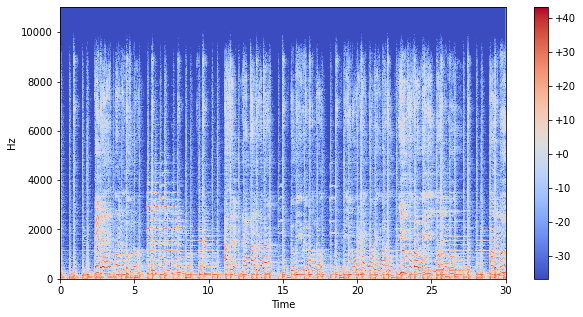

In [105]:
# 'Blues' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_blues, hop_length=1024))**2), sr, 1024)

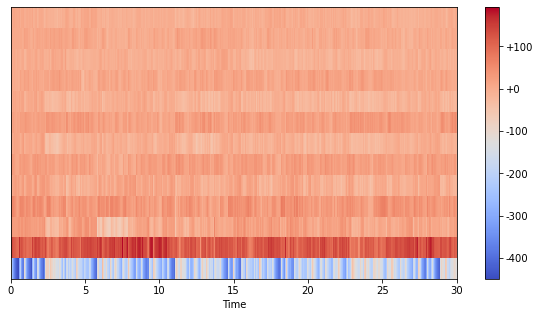

In [108]:
# 'Blues' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_blues, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1b. Classical

In [123]:
# 'Classical' sample audio file
song_classical, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/classical/classical.00003.wav')
IPython.display.Audio(song_classical, rate=sr)

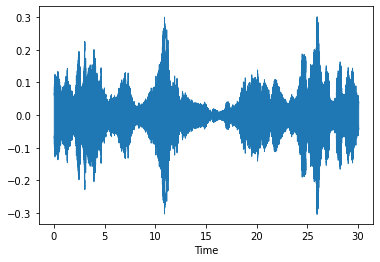

In [124]:
# 'Classical' wave plot: visual depiction of audio files
librosa.display.waveshow(song_classical)

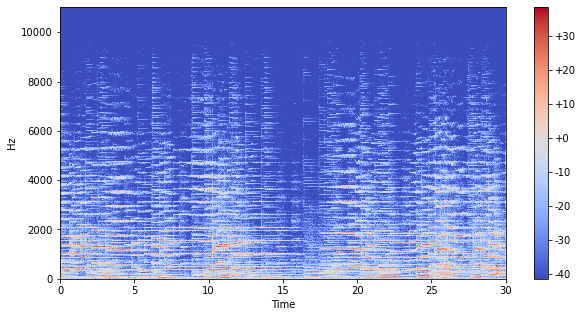

In [125]:
# 'Classical' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_classical, hop_length=1024))**2), sr, 1024)

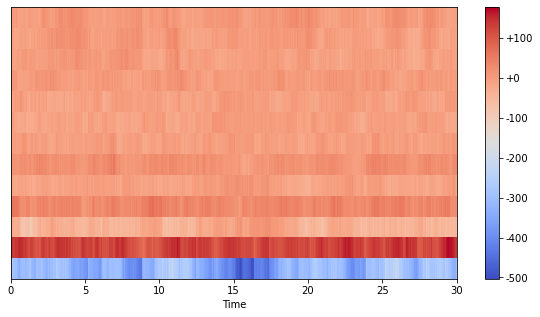

In [126]:
# 'Classical' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_classical, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1c. Country

In [127]:
# 'Country' sample audio file: 
song_country, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/country/country.00028.wav')
IPython.display.Audio(song_country, rate=sr)

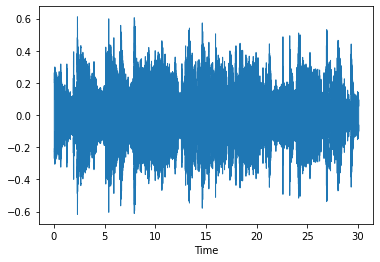

In [128]:
# 'Country' wave plot: visual depiction of audio files
librosa.display.waveshow(song_country)

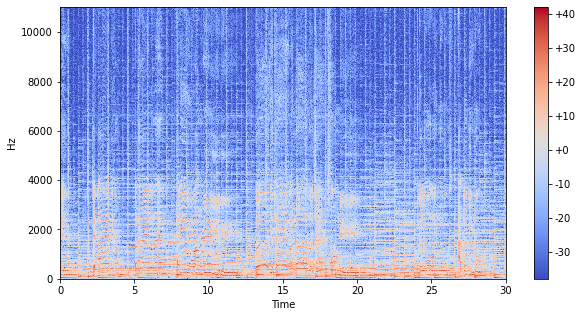

In [130]:
# 'Country' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_country, hop_length=1024))**2), sr, 1024)

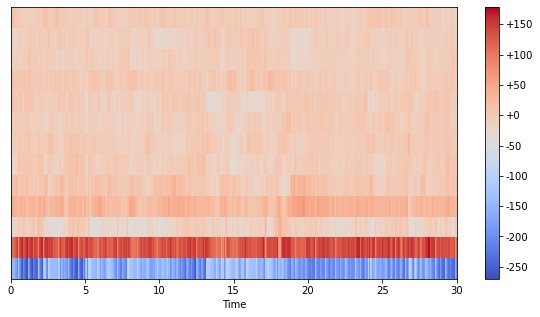

In [131]:
# 'Country' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_country, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1d. Disco

In [85]:
# 'Disco' sample audio file
song_disco, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/disco/disco.00001.wav')
IPython.display.Audio(song_disco, rate=sr)

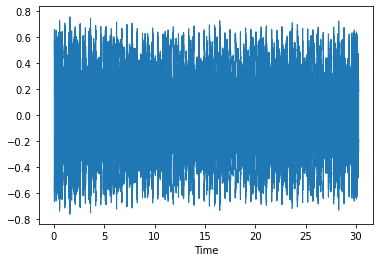

In [99]:
# 'Disco' wave plot: visual depiction of audio files
librosa.display.waveshow(song_disco)

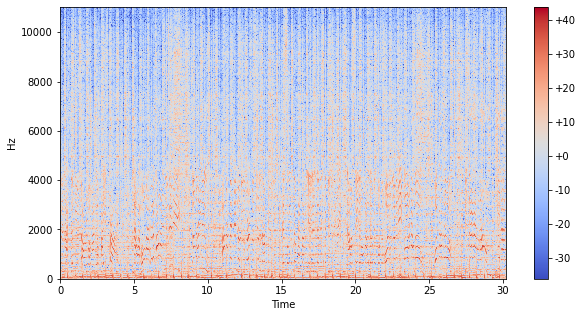

In [104]:
# 'Disco' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_disco, hop_length=1024))**2), sr, 1024)

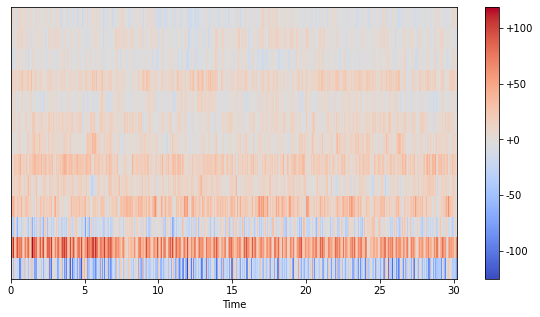

In [107]:
# 'Disco' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_disco, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1e. Hip-Hop

In [132]:
# 'Hip-Hop' sample audio file
song_hiphop, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/hiphop/hiphop.00001.wav')
IPython.display.Audio(song_hiphop, rate=sr)

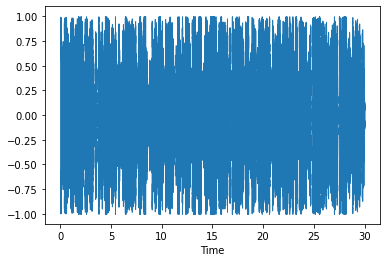

In [133]:
# 'Hip-Hop' wave plot: visual depiction of audio files
librosa.display.waveshow(song_hiphop)

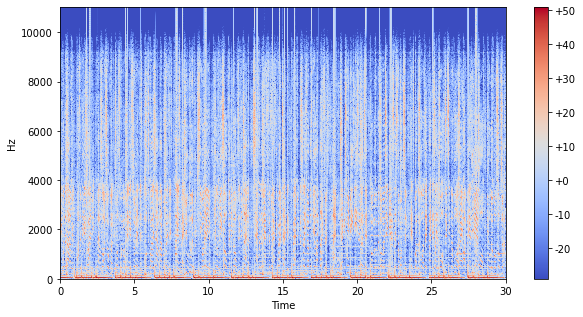

In [134]:
# 'Hip-Hop' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_hiphop, hop_length=1024))**2), sr, 1024)

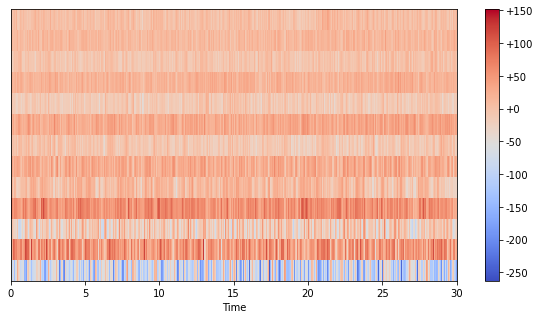

In [135]:
# 'Hip-Hop' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_hiphop, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1f. Jazz

In [138]:
# 'Jazz' sample audio file
song_jazz, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/jazz/jazz.00012.wav')
IPython.display.Audio(song_jazz, rate=sr)

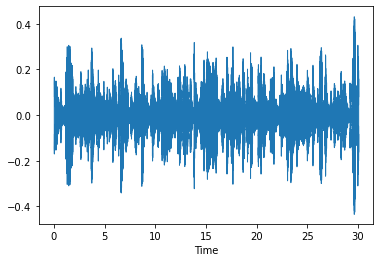

In [139]:
# 'Jazz' wave plot: visual depiction of audio files
librosa.display.waveshow(song_jazz)

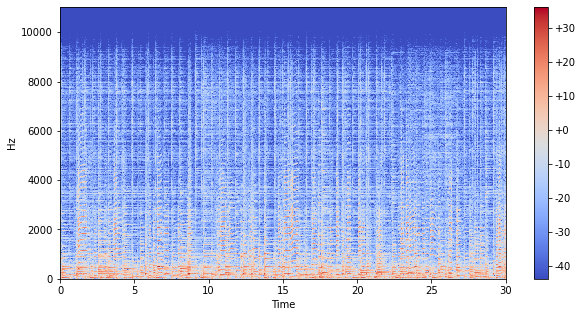

In [140]:
# 'Jazz' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_jazz, hop_length=1024))**2), sr, 1024)

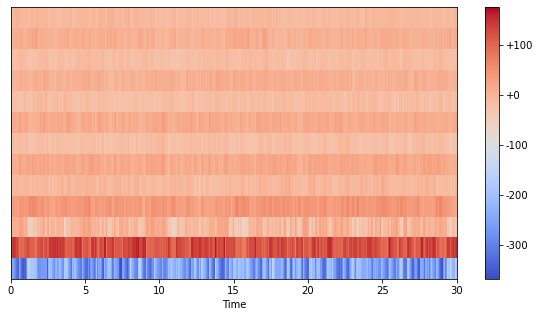

In [141]:
# 'Jazz' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_jazz, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1g. Metal

In [142]:
# 'Metal' sample audio file
song_metal, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/metal/metal.00000.wav')
IPython.display.Audio(song_metal, rate=sr)

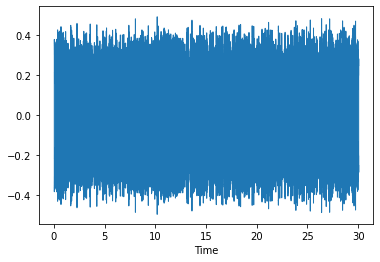

In [143]:
# 'Metal' wave plot: visual depiction of audio files
librosa.display.waveshow(song_metal)

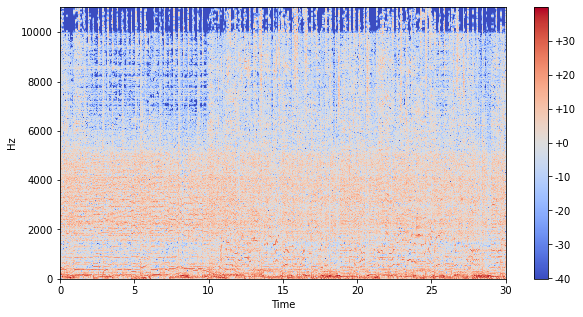

In [144]:
# 'Metal' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_metal, hop_length=1024))**2), sr, 1024)

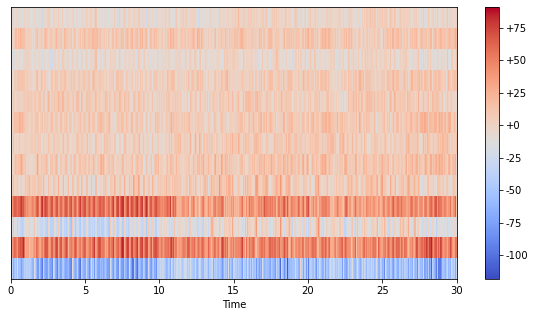

In [145]:
# 'Metal' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_metal, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1h. Pop

In [154]:
# 'Pop' sample audio file
song_pop, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/pop/pop.00028.wav')
IPython.display.Audio(song_pop, rate=sr)

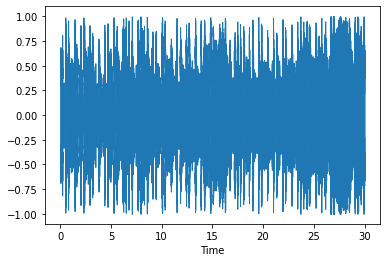

In [155]:
# 'Pop' wave plot: visual depiction of audio files
librosa.display.waveshow(song_pop)

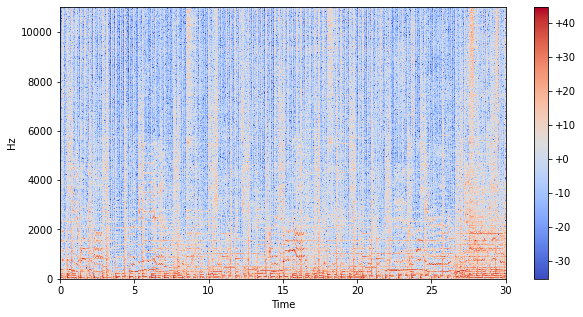

In [156]:
# 'Pop' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_pop, hop_length=1024))**2), sr, 1024)

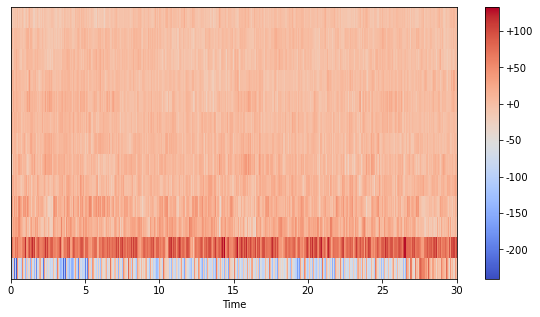

In [157]:
# 'Pop' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_pop, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1i. Reggae

In [113]:
# 'Reggae' sample audio file
song_reggae, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/reggae/reggae.00003.wav')
IPython.display.Audio(song_reggae, rate=sr)

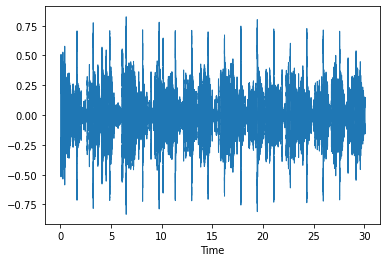

In [101]:
# 'Reggae' wave plot: visual depiction of audio files
plt4 = librosa.display.waveshow(song_reggae)

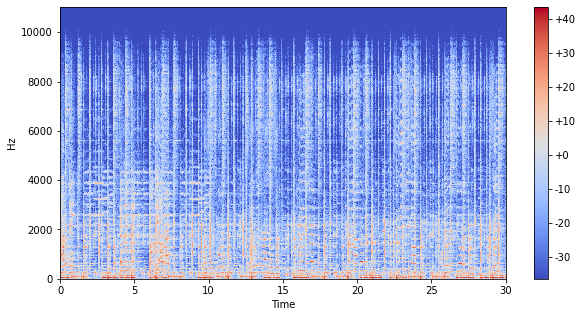

In [106]:
# 'Reggae' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_reggae, hop_length=1024))**2), sr, 1024)

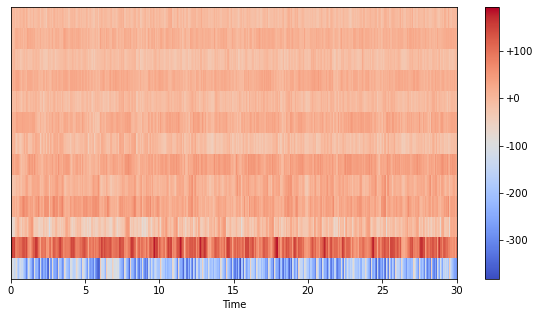

In [109]:
# 'Reggae' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_reggae, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1j. Rock

In [121]:
# 'Rock' sample audio file: 
song_rock, sr = librosa.load('C:/Users/James/Downloads/archive/Data/genres_original/rock/rock.00028.wav')
IPython.display.Audio(song_rock, rate=sr)

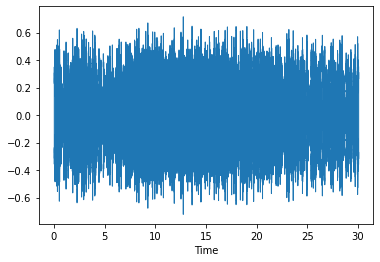

In [98]:
# 'Rock' wave plot: visual depiction of audio files
librosa.display.waveshow(song_rock)

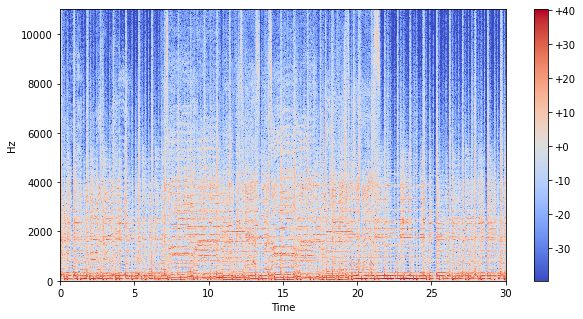

In [74]:
# 'Rock' spectrogram
plot_spectrogram(librosa.power_to_db(np.abs(librosa.stft(song_rock, hop_length=1024))**2), sr, 1024)

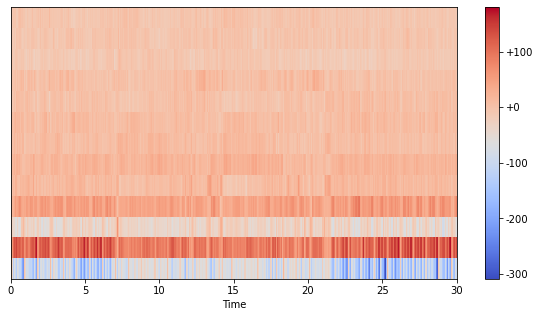

In [75]:
# 'Rock' MFCC (Mel-Frequency-Cepstral-Coefficients) display
plt.figure(figsize=(10, 5))
librosa.display.specshow(librosa.feature.mfcc(song_rock, n_mfcc=13, sr=sr), x_axis="time", sr=sr)
plt.colorbar(format="%+2.f")
plt.show()

# 1k. Data Augmentation and Preparation

In [4]:
# Data regularization and slicing

# Dataset location
SOURCE_PATH = 'C:/Users/James/Downloads/archive/Data/genres_original/'

# Path to labels and processed data file, json format.
JSON = 'C:/Users/James/Downloads/archive/Data/data.json'

# Sampling rate.
sr = 22050

# Let's make sure all files have the same amount of samples, pick a duration under 30 seconds.
TOTAL_SAMPLES = 29 * sr

# The dataset contains 999 files (after removal of corrupt file jazz.00054)
# Slice each file into 10 segments to increase sample size by 10x
NUM_SLICES = 10
SAMPLES_PER_SLICE = int(TOTAL_SAMPLES / NUM_SLICES)

In [5]:
# Create a dictionary of labels (genres) and processed data (.wav to MFCC).
mydict = {
    "labels": [],
    "mfcc": []
    }

# Let's browse each file, slice it and generate the mfcc for each slice.
for i, (dirpath, dirnames, filenames) in enumerate(os.walk(SOURCE_PATH)):
    
    for file in filenames:
        song, sr = librosa.load(os.path.join(dirpath, file), duration=29)
        
        for s in range(NUM_SLICES):
            start_sample = SAMPLES_PER_SLICE * s
            end_sample = start_sample + SAMPLES_PER_SLICE
            mfcc = librosa.feature.mfcc(y=song[start_sample:end_sample], sr=sr, n_mfcc=13)
            mfcc = mfcc.T
            mydict["labels"].append(i-1)
            mydict["mfcc"].append(mfcc.tolist())

# Write the dictionary in a json file
with open(JSON, 'w') as fp:
    json.dump(mydict, fp)

In [6]:
# Load the json file
with open(JSON) as f:
    data = json.load(f)
fp.close()

In [7]:
# Load the data into numpy arrays for TensorFlow compatibility
# input MFCCs, and target labels/genres
inputs = np.array(data["mfcc"])  
targets = np.array(data["labels"])

In [8]:
# Check inputs and targets arrays' shapes
# 9990 mfcc, 125 time frames per mfcc, 13 coefficients
print(inputs.shape)
# 9990 target labels/genres
print(targets.shape)

(9990, 125, 13)
(9990,)


In [10]:
# split inputs and targets into training (70%) and test sets (30%)
inputs_train, inputs_test, targets_train, targets_test = train_test_split(inputs, targets, test_size=0.3)

# Check shapes of inputs and targets training and test sets
print(inputs_train.shape)
print(targets_train.shape)
print(inputs_test.shape)
print(targets_test.shape)

(6993, 125, 13)
(6993,)
(2997, 125, 13)
(2997,)


# 2. MLP

In [118]:
# Design the model architecture.
model = tf.keras.models.Sequential([
    # input layer: flatten data to a one dimensional array
    tf.keras.layers.Flatten(input_shape=(inputs.shape[1], inputs.shape[2])),

    # hidden Dense layers

#     tf.keras.layers.Dense(512, activation='sigmoid'),
#     tf.keras.layers.Dense(512, activation='sigmoid'),
#     tf.keras.layers.Dense(256, activation='sigmoid'),
#     tf.keras.layers.Dense(128, activation='sigmoid'), 
#     tf.keras.layers.Dense(64, activation='sigmoid'), 
    
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(512, activation='relu'),
    tf.keras.layers.Dense(256, activation='relu'),
#     tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dense(128, activation='relu'), 
#     tf.keras.layers.Dense(128, activation='relu'), 
    tf.keras.layers.Dense(64, activation='relu'), 
    
    # output layer: 10 nodes (1 for each music genre)
    tf.keras.layers.Dense(len(np.unique(targets)), activation='softmax')
])

# Compiler: selection of the optimizer, loss type and metrics for performance evaluation.

# RMSprop optimizer
model.compile(optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001, name='RMSprop'),
             loss='sparse_categorical_crossentropy',
              metrics = ['acc']
             )

# Adam optimizer
# model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.001, name='Adam'),
#              loss='sparse_categorical_crossentropy',
#               metrics = ['acc']
#              )

In [119]:
# Training the model
t1_start = process_time()  
history = model.fit(inputs_train, targets_train, 
                    validation_data=(inputs_test, targets_test), 
                    epochs=100, batch_size=32
                   )
t1_stop = process_time()  

Epoch 1/100
219/219 [==============================] - 4s 17ms/step - loss: 6.3235 - acc: 0.1996 - val_loss: 2.2423 - val_acc: 0.1281
Epoch 2/100
219/219 [==============================] - 4s 16ms/step - loss: 2.2174 - acc: 0.2367 - val_loss: 1.9147 - val_acc: 0.3337
Epoch 3/100
219/219 [==============================] - 9s 40ms/step - loss: 1.8742 - acc: 0.3462 - val_loss: 1.7787 - val_acc: 0.3660
Epoch 4/100
219/219 [==============================] - 11s 49ms/step - loss: 1.6555 - acc: 0.4164 - val_loss: 1.7000 - val_acc: 0.3650
Epoch 5/100
219/219 [==============================] - 8s 39ms/step - loss: 1.5179 - acc: 0.4627 - val_loss: 1.9838 - val_acc: 0.3717
Epoch 6/100
219/219 [==============================] - 12s 56ms/step - loss: 1.4485 - acc: 0.4898 - val_loss: 1.4582 - val_acc: 0.5068
Epoch 7/100
219/219 [==============================] - 10s 46ms/step - loss: 1.3804 - acc: 0.5118 - val_loss: 1.7428 - val_acc: 0.4658
Epoch 8/100
219/219 [==============================] - 10s 

219/219 [==============================] - 8s 37ms/step - loss: 2.4882 - acc: 0.5124 - val_loss: 9.7221 - val_acc: 0.4468
Epoch 62/100
219/219 [==============================] - 9s 42ms/step - loss: 1.8324 - acc: 0.4762 - val_loss: 6.2449 - val_acc: 0.3560
Epoch 63/100
219/219 [==============================] - 7s 34ms/step - loss: 2.3389 - acc: 0.4376 - val_loss: 5.5348 - val_acc: 0.3500
Epoch 64/100
219/219 [==============================] - 8s 37ms/step - loss: 1.8354 - acc: 0.4307 - val_loss: 2.9162 - val_acc: 0.2519
Epoch 65/100
219/219 [==============================] - 7s 33ms/step - loss: 2.7291 - acc: 0.4041 - val_loss: 4.9975 - val_acc: 0.2856
Epoch 66/100
219/219 [==============================] - 10s 45ms/step - loss: 2.5031 - acc: 0.4226 - val_loss: 3.0505 - val_acc: 0.3267
Epoch 67/100
219/219 [==============================] - 10s 47ms/step - loss: 2.2338 - acc: 0.4676 - val_loss: 4.4979 - val_acc: 0.3767
Epoch 68/100
219/219 [==============================] - 10s 45ms/s

Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_61 (Flatten)        (None, 1625)              0         
                                                                 
 dense_320 (Dense)           (None, 512)               832512    
                                                                 
 dense_321 (Dense)           (None, 512)               262656    
                                                                 
 dense_322 (Dense)           (None, 256)               131328    
                                                                 
 dense_323 (Dense)           (None, 256)               65792     
                                                                 
 dense_324 (Dense)           (None, 128)               32896     
                                                                 
 dense_325 (Dense)           (None, 64)              

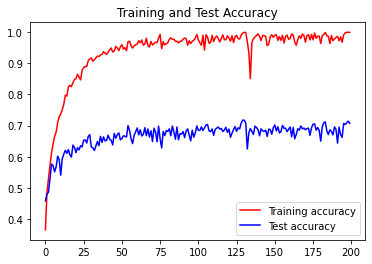

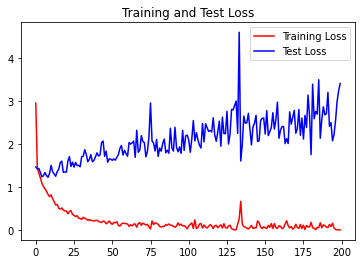

In [399]:
# Model summary
model.summary()

# Processing Time of the model
print("Elapsed time:", round((t1_stop-t1_start)/360,2),"m")  

# Final evaluation of the model
scores = model.evaluate(inputs_test, targets_test, verbose=0)
print("Accuracy: %.2f%%" % (scores[1]*100))

# Plot the training and test accuracy and loss
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))
plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Test accuracy')
plt.title('Training and Test Accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Test Loss')
plt.title('Training and Test Loss')
plt.legend()
plt.show()

In [400]:
# Classification Report: Review accuracy predictions by class (music genre)
labels = ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']
predictions = np.argmax(model.predict(inputs_test),axis=-1)
print(classification_report(targets_test, predictions, target_names = labels))

              precision    recall  f1-score   support

       blues       0.73      0.79      0.76       295
   classical       0.88      0.90      0.89       299
     country       0.55      0.64      0.59       327
       disco       0.75      0.58      0.65       313
      hiphop       0.77      0.57      0.66       307
        jazz       0.62      0.79      0.70       298
       metal       0.83      0.88      0.86       266
         pop       0.81      0.76      0.79       285
      reggae       0.72      0.56      0.63       306
        rock       0.55      0.64      0.59       301

    accuracy                           0.71      2997
   macro avg       0.72      0.71      0.71      2997
weighted avg       0.72      0.71      0.71      2997



Text(0.5, 42.0, 'Predicted')

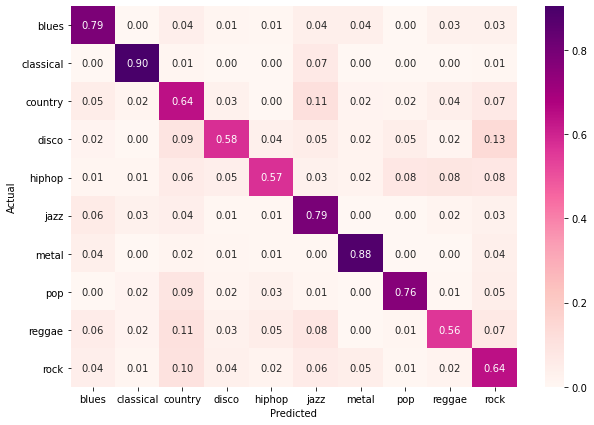

In [401]:
# Confusion matrix: Recall and Incorrect Classifications
# create confusion matrix
cm1 = confusion_matrix(targets_test, predictions)
# normalize confusion matrix
cm1n = cm1.astype('float') / cm1.sum(axis=1)[:, np.newaxis]

fig, ax = plt.subplots(figsize=(10,7))
df_cm1n = pd.DataFrame(cm1n, index = [i for i in labels],
              columns = [i for i in labels])
sn.heatmap(df_cm1n, annot=True, fmt='.2f', cmap="RdPu")
plt.ylabel('Actual')
plt.xlabel('Predicted')

# 3. CNN

In [11]:
# CNN model expects 3D input shape, rename for CNN
X_train = inputs_train[..., np.newaxis]
X_test = inputs_test[..., np.newaxis]
input_shape = (X_train.shape[1], X_train.shape[2], 1)
# Copy/separate target data sets for CNN
Y_train = targets_train
Y_test  = targets_test

In [218]:
# Design the model architecture.
model = tf.keras.models.Sequential([    
    
    # Covolutional hidden layer sequences
    tf.keras.layers.Conv2D(32, (3,3), activation='relu', input_shape=input_shape),
    tf.keras.layers.MaxPooling2D((3,3), strides=(2,2), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.4),

    tf.keras.layers.Conv2D(32, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D((3,3), strides=(2,2), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.3),

    tf.keras.layers.Conv2D(32, (2,2), activation='relu'),
    tf.keras.layers.MaxPooling2D((3,3), strides=(2,2), padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.2),
    
    # flatten data to a one dimensional array
    tf.keras.layers.Flatten(),
    
    # hidden Dense layers
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(64, activation='relu'),
    
    # output layer: 10 nodes (1 for each music genre)
    tf.keras.layers.Dense(len(np.unique(targets)), activation='softmax')
])

# Selection of the optimizer, loss type and metrics for performance evaluation.
# model.compile(optimizer = tf.keras.optimizers.RMSprop(learning_rate=0.001, name='RMSprop'),
#              loss='sparse_categorical_crossentropy',
#               metrics = ['acc']
#              )

model.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.001, name='Adam'),
             loss='sparse_categorical_crossentropy',
              metrics = ['acc']
             )

In [219]:
# Training the model
t1_start = process_time()  
history = model.fit(X_train, Y_train, 
                    validation_data=(X_test, Y_test), 
                    epochs=200, batch_size=32
                   )
t1_stop = process_time()  

Epoch 1/200
219/219 [==============================] - 18s 79ms/step - loss: 1.6463 - acc: 0.3967 - val_loss: 1.6533 - val_acc: 0.4047
Epoch 2/200
219/219 [==============================] - 18s 83ms/step - loss: 1.2724 - acc: 0.5310 - val_loss: 1.4998 - val_acc: 0.4588
Epoch 3/200
219/219 [==============================] - 17s 79ms/step - loss: 1.1224 - acc: 0.5854 - val_loss: 1.3560 - val_acc: 0.5165
Epoch 4/200
219/219 [==============================] - 18s 82ms/step - loss: 1.0244 - acc: 0.6292 - val_loss: 1.1493 - val_acc: 0.6109
Epoch 5/200
219/219 [==============================] - 19s 85ms/step - loss: 0.9546 - acc: 0.6577 - val_loss: 1.0929 - val_acc: 0.6109
Epoch 6/200
219/219 [==============================] - 20s 91ms/step - loss: 0.8984 - acc: 0.6744 - val_loss: 1.0681 - val_acc: 0.6146
Epoch 7/200
219/219 [==============================] - 18s 81ms/step - loss: 0.8425 - acc: 0.6941 - val_loss: 0.9697 - val_acc: 0.6760
Epoch 8/200
219/219 [==============================] - 

219/219 [==============================] - 7s 33ms/step - loss: 0.2524 - acc: 0.9078 - val_loss: 0.7557 - val_acc: 0.7871
Epoch 62/200
219/219 [==============================] - 7s 32ms/step - loss: 0.2306 - acc: 0.9169 - val_loss: 0.7901 - val_acc: 0.7814
Epoch 63/200
219/219 [==============================] - 7s 31ms/step - loss: 0.2347 - acc: 0.9163 - val_loss: 0.8136 - val_acc: 0.7774
Epoch 64/200
219/219 [==============================] - 7s 33ms/step - loss: 0.2275 - acc: 0.9201 - val_loss: 0.8202 - val_acc: 0.7768
Epoch 65/200
219/219 [==============================] - 7s 31ms/step - loss: 0.2188 - acc: 0.9238 - val_loss: 0.7987 - val_acc: 0.7814
Epoch 66/200
219/219 [==============================] - 7s 34ms/step - loss: 0.2385 - acc: 0.9191 - val_loss: 0.7463 - val_acc: 0.7965
Epoch 67/200
219/219 [==============================] - 7s 34ms/step - loss: 0.2292 - acc: 0.9193 - val_loss: 0.7396 - val_acc: 0.7888
Epoch 68/200
219/219 [==============================] - 8s 38ms/step

219/219 [==============================] - 7s 33ms/step - loss: 0.1537 - acc: 0.9478 - val_loss: 0.7745 - val_acc: 0.8061
Epoch 122/200
219/219 [==============================] - 7s 34ms/step - loss: 0.1512 - acc: 0.9467 - val_loss: 0.8664 - val_acc: 0.7965
Epoch 123/200
219/219 [==============================] - 7s 30ms/step - loss: 0.1432 - acc: 0.9497 - val_loss: 0.7653 - val_acc: 0.8155
Epoch 124/200
219/219 [==============================] - 7s 32ms/step - loss: 0.1525 - acc: 0.9482 - val_loss: 0.8401 - val_acc: 0.7998
Epoch 125/200
219/219 [==============================] - 8s 37ms/step - loss: 0.1516 - acc: 0.9477 - val_loss: 0.8581 - val_acc: 0.8015
Epoch 126/200
219/219 [==============================] - 9s 43ms/step - loss: 0.1538 - acc: 0.9484 - val_loss: 0.8032 - val_acc: 0.8058
Epoch 127/200
219/219 [==============================] - 8s 36ms/step - loss: 0.1549 - acc: 0.9458 - val_loss: 0.7825 - val_acc: 0.8101
Epoch 128/200
219/219 [==============================] - 7s 32

Epoch 181/200
219/219 [==============================] - 19s 86ms/step - loss: 0.1216 - acc: 0.9561 - val_loss: 0.9167 - val_acc: 0.7925
Epoch 182/200
219/219 [==============================] - 19s 87ms/step - loss: 0.1305 - acc: 0.9542 - val_loss: 0.8151 - val_acc: 0.8138
Epoch 183/200
219/219 [==============================] - 19s 85ms/step - loss: 0.1152 - acc: 0.9610 - val_loss: 0.7896 - val_acc: 0.8135
Epoch 184/200
219/219 [==============================] - 19s 86ms/step - loss: 0.1183 - acc: 0.9580 - val_loss: 0.8451 - val_acc: 0.8091
Epoch 185/200
219/219 [==============================] - 19s 86ms/step - loss: 0.1062 - acc: 0.9630 - val_loss: 0.8259 - val_acc: 0.8108
Epoch 186/200
219/219 [==============================] - 18s 83ms/step - loss: 0.1172 - acc: 0.9577 - val_loss: 0.9233 - val_acc: 0.7981
Epoch 187/200
219/219 [==============================] - 19s 85ms/step - loss: 0.1341 - acc: 0.9557 - val_loss: 0.8158 - val_acc: 0.8115
Epoch 188/200
219/219 [==================

Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_149 (Conv2D)         (None, 123, 11, 32)       320       
                                                                 
 max_pooling2d_149 (MaxPooli  (None, 62, 6, 32)        0         
 ng2D)                                                           
                                                                 
 batch_normalization_148 (Ba  (None, 62, 6, 32)        128       
 tchNormalization)                                               
                                                                 
 dropout_123 (Dropout)       (None, 62, 6, 32)         0         
                                                                 
 conv2d_150 (Conv2D)         (None, 60, 4, 32)         9248      
                                                                 
 max_pooling2d_150 (MaxPooli  (None, 30, 2, 32)      

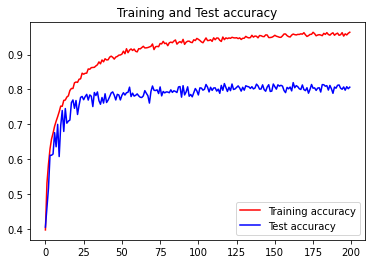

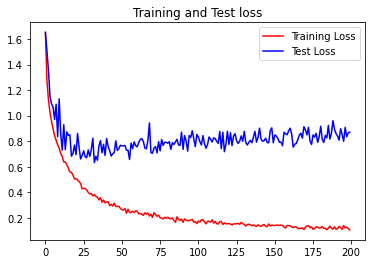

In [220]:
# Model summary
model.summary()

print("Elapsed time:", round((t1_stop-t1_start)/360,2),"m")  

# Final evaluation of the model
scores = model.evaluate(X_test, Y_test, verbose=0)
print("Accuracy: %.2f%%" % (scores[1]*100))

# Plot the training and test accuracy and loss
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))
plt.plot(epochs, acc, 'r', label='Training accuracy')
plt.plot(epochs, val_acc, 'b', label='Test accuracy')
plt.title('Training and Test accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'r', label='Training Loss')
plt.plot(epochs, val_loss, 'b', label='Test Loss')
plt.title('Training and Test loss')
plt.legend()
plt.show()

In [221]:
# Classification Report: Review accuracy predictions by class (music genre)
labels = ['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']
predictions_cnn = np.argmax(model.predict(X_test),axis=-1)
print(classification_report(Y_test, predictions_cnn, target_names = labels))

              precision    recall  f1-score   support

       blues       0.89      0.81      0.85       294
   classical       0.83      1.00      0.91       293
     country       0.69      0.79      0.74       291
       disco       0.73      0.80      0.76       286
      hiphop       0.83      0.79      0.81       304
        jazz       0.91      0.77      0.84       306
       metal       0.80      0.95      0.87       313
         pop       0.86      0.77      0.81       308
      reggae       0.85      0.77      0.81       300
        rock       0.70      0.61      0.65       302

    accuracy                           0.81      2997
   macro avg       0.81      0.81      0.80      2997
weighted avg       0.81      0.81      0.81      2997



Text(0.5, 42.0, 'Predicted')

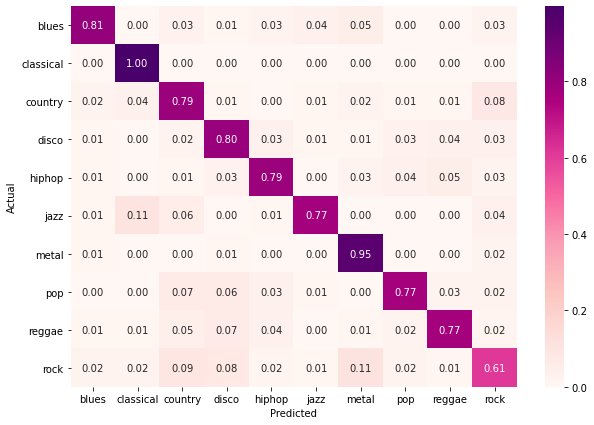

In [222]:
# Confusion matrix: Recall and Incorrect Classifications
# create confusion matrix
cm2 = confusion_matrix(Y_test, predictions_cnn)
# normalize confusion matrix
cm2n = cm2.astype('float') / cm2.sum(axis=1)[:, np.newaxis]

fig, ax = plt.subplots(figsize=(10,7))
df_cm2n = pd.DataFrame(cm2n, index = [i for i in labels],
              columns = [i for i in labels])
sn.heatmap(df_cm2n, annot=True, fmt='.2f', cmap="RdPu")
plt.ylabel('Actual')
plt.xlabel('Predicted')